In [1]:
import os
import cv2
import torch
import imagehash
import numpy as np
import pandas as pd
from PIL import Image
from pathlib import Path

import matplotlib.pylab as plt

from tqdm import tqdm

tqdm.pandas()

from pandarallel import pandarallel

pandarallel.initialize(progress_bar=True)


def load_image_and_hash(series):
    funcs = [
        imagehash.average_hash,
        imagehash.phash,
        imagehash.dhash,
        imagehash.whash,
    ]

    image = Image.open(series.file)
    return (
        np.array([f(image).hash for f in funcs]).reshape(256).astype(np.uint8)
    )


def compare(row1, row2):
    fig, axs = plt.subplots(nrows=1, ncols=2, figsize=(15, 20))
    for ax, row in zip(axs, (row1, row2)):
        image = cv2.imread(str(row.file))
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        ax.imshow(image)
        ax.axis("off")
        ax.set_title(f"{row.Id}: {row.Pawpularity}")
    plt.tight_layout()
    plt.show()


data_path = Path("../input/petfinder-pawpularity-score")

train_df = (
    pd.read_csv(data_path.joinpath("train.csv"))
    .assign(
        file=lambda x: str(data_path.joinpath("train"))
        + os.path.sep
        + x.Id
        + ".jpg"
    )
    .assign(hashes=lambda x: x.parallel_apply(load_image_and_hash, axis=1))
)

train_hashes = torch.from_numpy(np.array(train_df.hashes.to_list())).cuda()
sims = (
    np.array(
        [
            (train_hashes[i] == train_hashes).sum(dim=1).cpu().numpy()
            for i in range(train_hashes.shape[0])
        ]
    )
    / 256
)


indices1 = np.where(sims > 0.9)
indices2 = np.where(indices1[0] != indices1[1])
petids1 = train_df.iloc[indices1[0][indices2]].Id.values
petids2 = train_df.iloc[indices1[1][indices2]].Id.values
petids1.shape, petids2.shape
duplicates = sorted(set(map(tuple, (map(sorted, zip(petids1, petids2))))))


INFO: Pandarallel will run on 2 workers.
INFO: Pandarallel will use Memory file system to transfer data between the main process and workers.


## Similary Images

In [10]:
sims = ['13d215b4c71c3dc603cd13fc3ec80181_373c763f5218610e9b3f82b12ada8ae5',
       '5ef7ba98fc97917aec56ded5d5c2b099_67e97de8ec7ddcda59a58b027263cdcc',
       '839087a28fa67bf97cdcaf4c8db458ef_a8f044478dba8040cc410e3ec7514da1',
       '1feb99c2a4cac3f3c4f8a4510421d6f5_264845a4236bc9b95123dde3fb809a88',
       '3c50a7050df30197e47865d08762f041_def7b2f2685468751f711cc63611e65b',
       '37ae1a5164cd9ab4007427b08ea2c5a3_3f0222f5310e4184a60a7030da8dc84b',
       '5a642ecc14e9c57a05b8e010414011f2_c504568822c53675a4f425c8e5800a36',
       '2a8409a5f82061e823d06e913dee591c_86a71a412f662212fe8dcd40fdaee8e6',
       '3c602cbcb19db7a0998e1411082c487d_a8bb509cd1bd09b27ff5343e3f36bf9e',
       '0422cd506773b78a6f19416c98952407_0b04f9560a1f429b7c48e049bcaffcca',
       '68e55574e523cf1cdc17b60ce6cc2f60_9b3267c1652691240d78b7b3d072baf3',
       '1059231cf2948216fcc2ac6afb4f8db8_bca6811ee0a78bdcc41b659624608125',
       '5da97b511389a1b62ef7a55b0a19a532_8ffde3ae7ab3726cff7ca28697687a42',
       '78a02b3cb6ed38b2772215c0c0a7f78e_c25384f6d93ca6b802925da84dfa453e',
       '08440f8c2c040cf2941687de6dc5462f_bf8501acaeeedc2a421bac3d9af58bb7',
       '0c4d454d8f09c90c655bd0e2af6eb2e5_fe47539e989df047507eaa60a16bc3fd',
       '5a5c229e1340c0da7798b26edf86d180_dd042410dc7f02e648162d7764b50900',
       '871bb3cbdf48bd3bfd5a6779e752613e_988b31dd48a1bc867dbc9e14d21b05f6',
       'dbf25ce0b2a5d3cb43af95b2bd855718_e359704524fa26d6a3dcd8bfeeaedd2e',
       '43bd09ca68b3bcdc2b0c549fd309d1ba_6ae42b731c00756ddd291fa615c822a1',
       '43ab682adde9c14adb7c05435e5f2e0e_9a0238499efb15551f06ad583a6fa951',
       'a9513f7f0c93e179b87c01be847b3e4c_b86589c3e85f784a5278e377b726a4d4',
       '38426ba3cbf5484555f2b5e9504a6b03_6cb18e0936faa730077732a25c3dfb94',
       '589286d5bfdc1b26ad0bf7d4b7f74816_cd909abf8f425d7e646eebe4d3bf4769',
       '9f5a457ce7e22eecd0992f4ea17b6107_b967656eb7e648a524ca4ffbbc172c06',
       'b148cbea87c3dcc65a05b15f78910715_e09a818b7534422fb4c688f12566e38f',
       '3877f2981e502fe1812af38d4f511fd2_902786862cbae94e890a090e5700298b',
       '8f20c67f8b1230d1488138e2adbb0e64_b190f25b33bd52a8aae8fd81bd069888',
       '221b2b852e65fe407ad5fd2c8e9965ef_94c823294d542af6e660423f0348bf31',
       '2b737750362ef6b31068c4a4194909ed_41c85c2c974cc15ca77f5ababb652f84',
       '01430d6ae02e79774b651175edd40842_6dc1ae625a3bfb50571efedc0afc297c',
       '72b33c9c368d86648b756143ab19baeb_763d66b9cf01069602a968e573feb334',
       '03d82e64d1b4d99f457259f03ebe604d_dbc47155644aeb3edd1bd39dba9b6953',
       '851c7427071afd2eaf38af0def360987_b49ad3aac4296376d7520445a27726de',
       '54563ff51aa70ea8c6a9325c15f55399_b956edfd0677dd6d95de6cb29a85db9c',
       '87c6a8f85af93b84594a36f8ffd5d6b8_d050e78384bd8b20e7291b3efedf6a5b',
       '04201c5191c3b980ae307b20113c8853_16d8e12207ede187e65ab45d7def117b']
similary_images = pd.Series(sims).str.extract(r"(?P<left>\w+)_(?P<right>\w+)")
similary_images.shape

(37, 2)

In [11]:
similary_images

,left,right
0,13d215b4c71c3dc603cd13fc3ec80181,373c763f5218610e9b3f82b12ada8ae5
1,5ef7ba98fc97917aec56ded5d5c2b099,67e97de8ec7ddcda59a58b027263cdcc
2,839087a28fa67bf97cdcaf4c8db458ef,a8f044478dba8040cc410e3ec7514da1
3,1feb99c2a4cac3f3c4f8a4510421d6f5,264845a4236bc9b95123dde3fb809a88
4,3c50a7050df30197e47865d08762f041,def7b2f2685468751f711cc63611e65b
5,37ae1a5164cd9ab4007427b08ea2c5a3,3f0222f5310e4184a60a7030da8dc84b
6,5a642ecc14e9c57a05b8e010414011f2,c504568822c53675a4f425c8e5800a36
7,2a8409a5f82061e823d06e913dee591c,86a71a412f662212fe8dcd40fdaee8e6
8,3c602cbcb19db7a0998e1411082c487d,a8bb509cd1bd09b27ff5343e3f36bf9e
9,0422cd506773b78a6f19416c98952407,0b04f9560a1f429b7c48e049bcaffcca


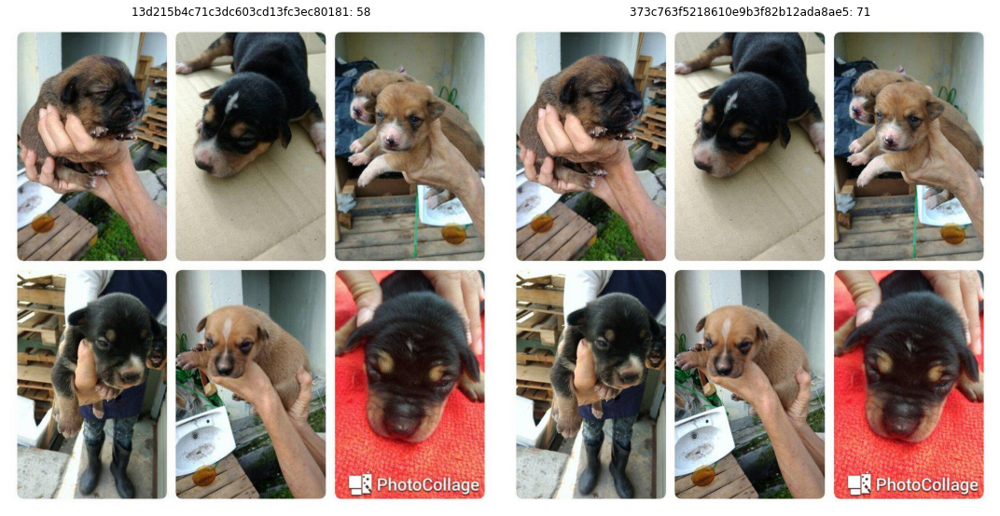

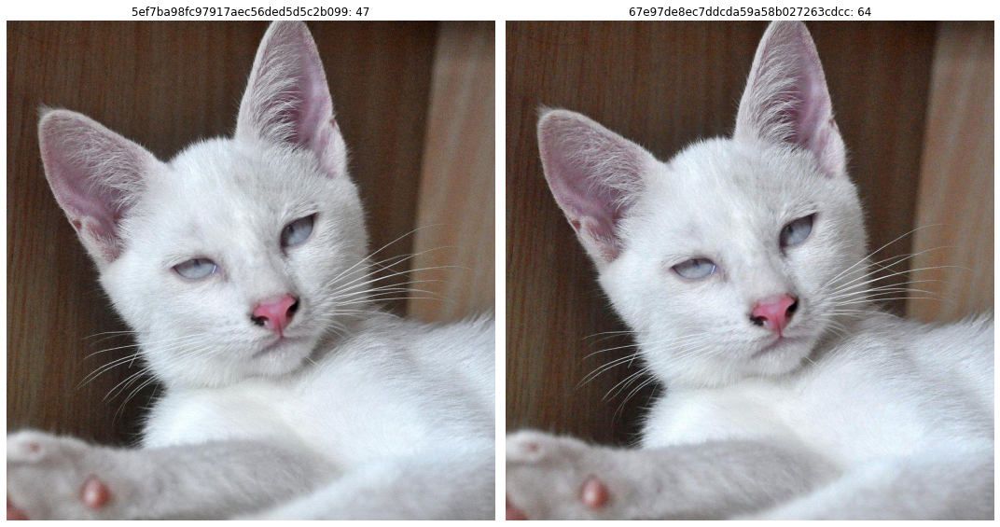

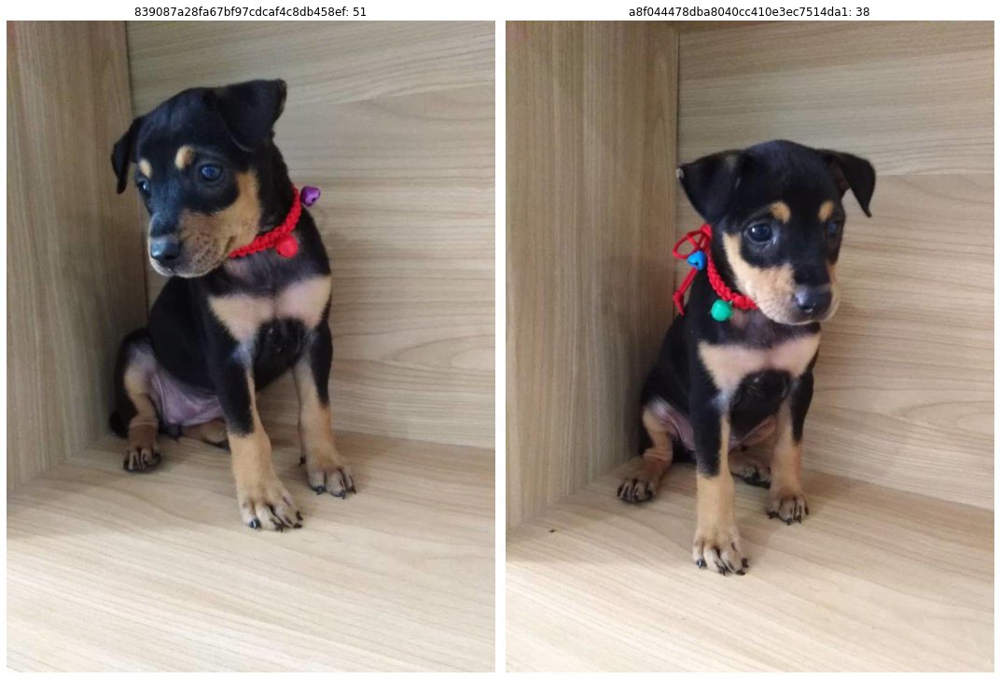

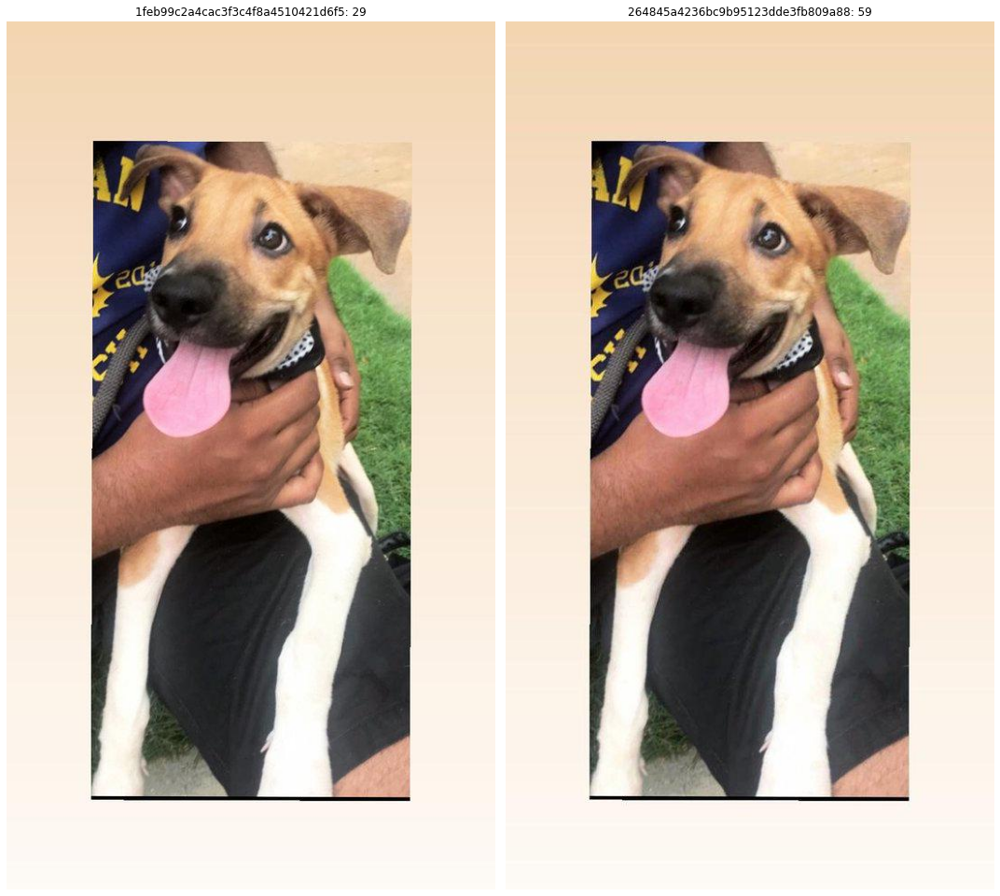

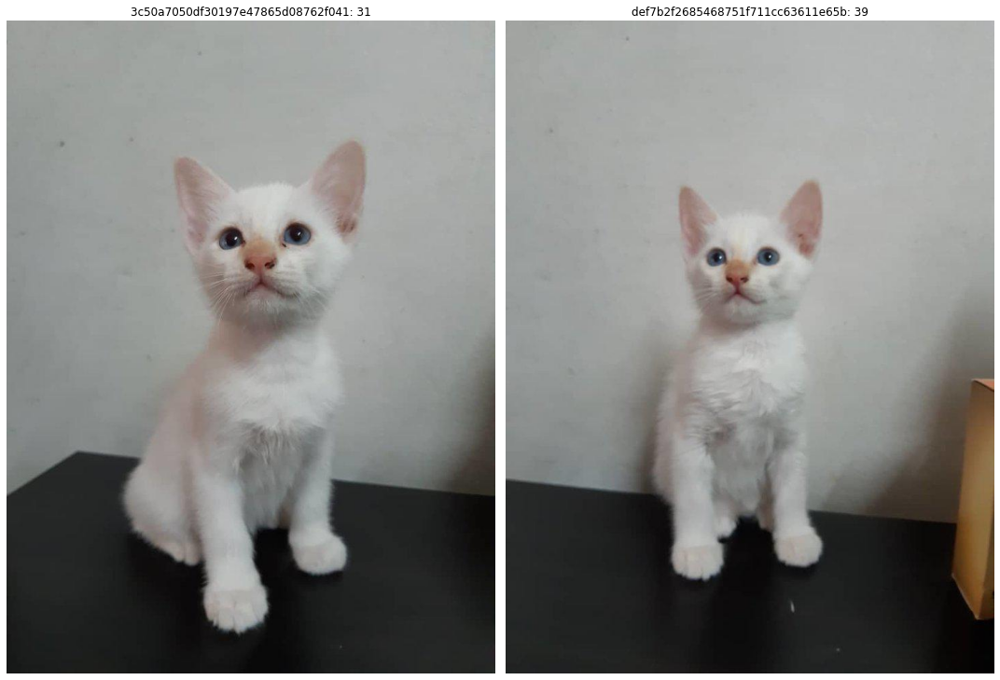

...

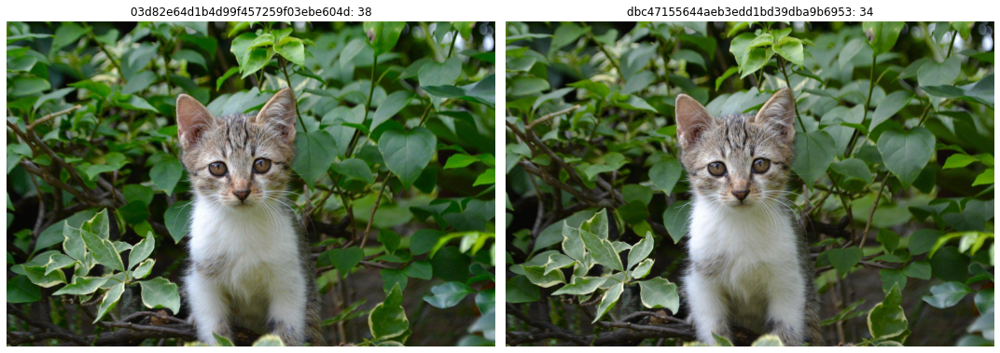

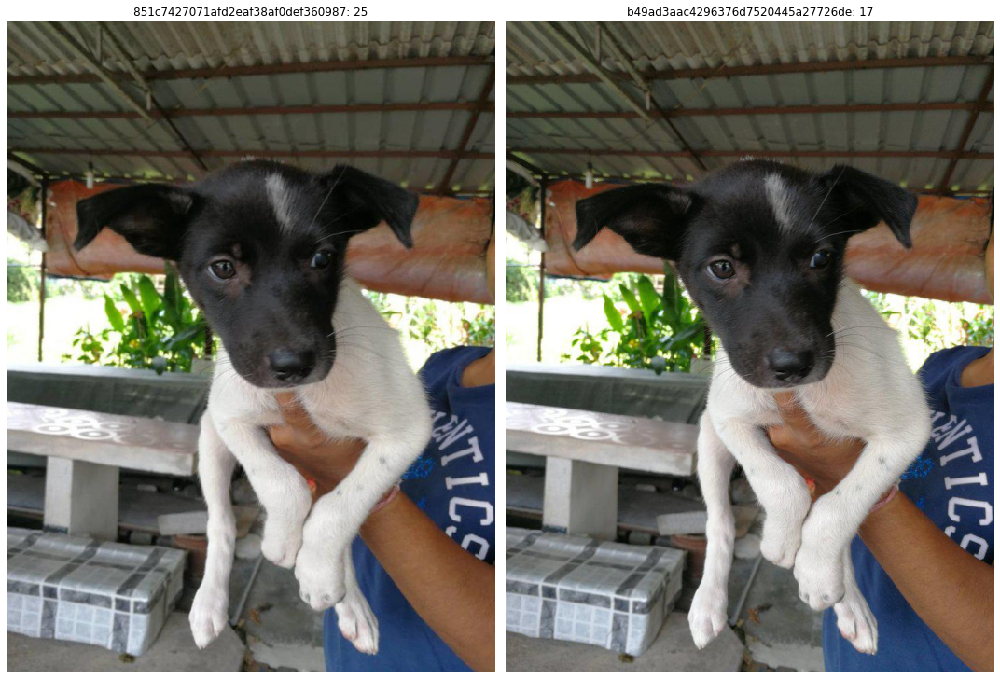

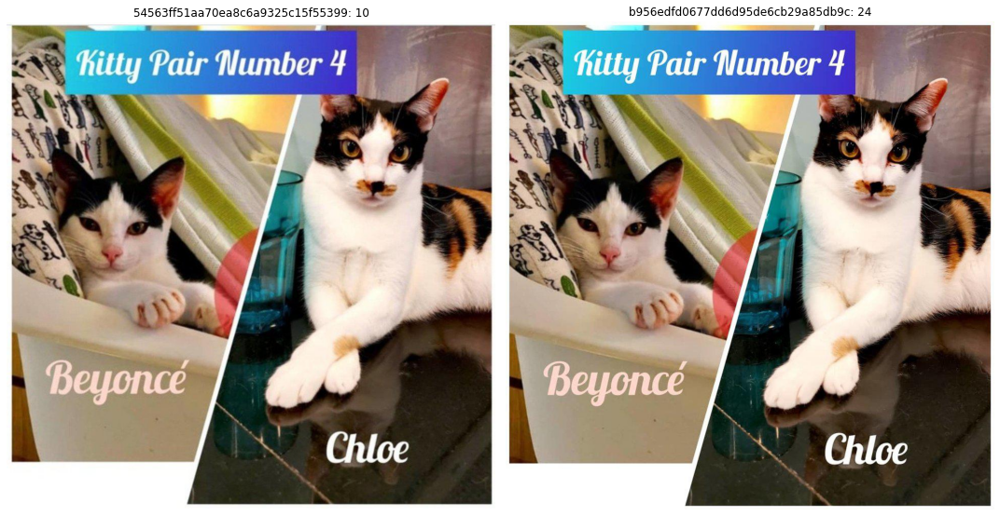

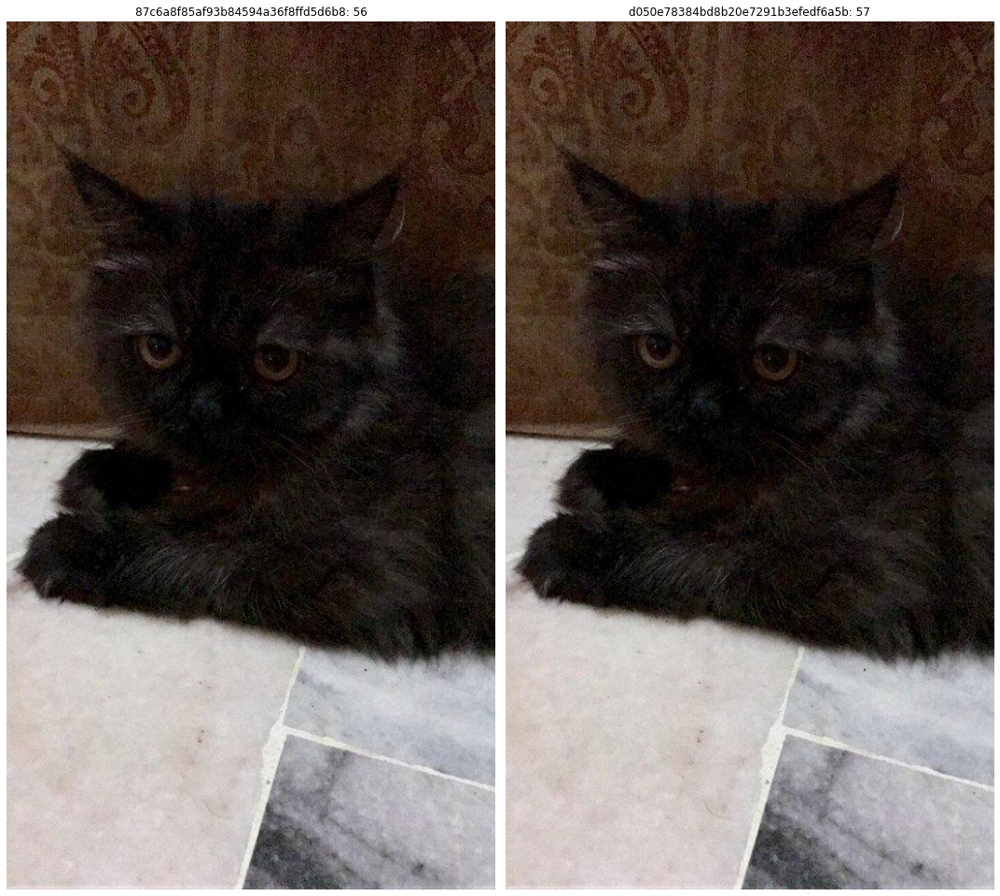

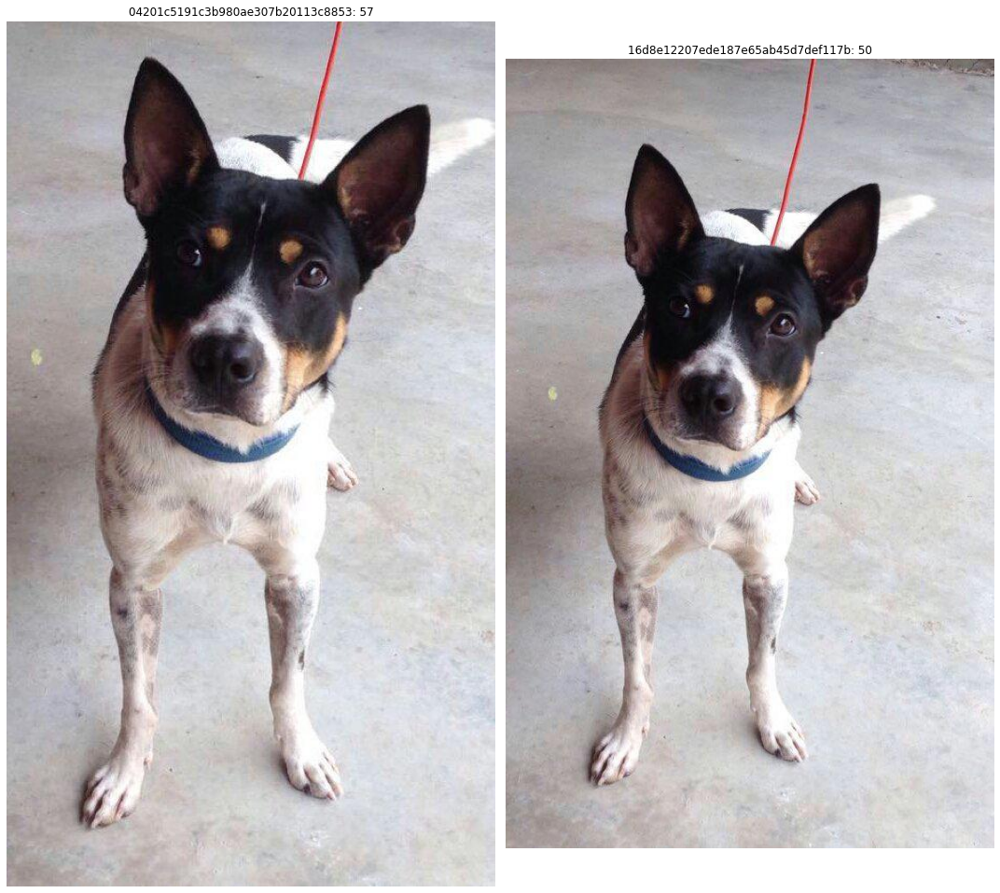

In [12]:
for _, (petid1, petid2) in similary_images.iterrows():
    if petid1==petid2:
        continue
    compare(train_df.query("Id==@petid1").squeeze(), train_df.query("Id==@petid2").squeeze())